# Predicting earthquakes with high accuracy when we have access to only a few parameters

## Why did we choose this?
#### Earthquakes cause a great deal of loss in terms of human lives and destruction of infrastructure. Predicting the magnitude of Earthquakes using data collected from a large timeline can help in the timely implementation of precautionary measures by the general public.

## Sample collection:
#### 1. Earthquakes with magnitude greater than 5.5 from 1965 to 2016
#### 2. Tectonic plates boundary data

## Problem statement:
#### To determine the most effective time forecasting or regression model for predicting major earthquakes’ magnitude and the most effective classification model to predict the RANGE of  major earthquakes’ magnitudes based on geographical coordinates (latitude/longitude) and depth.

***

## Importing libraries and loading datasets

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import Choropleth
from folium.plugins import HeatMap
import datetime

np.random.seed(0)

In [ ]:
# Loading earthquake data
data = pd.read_csv("earthquake database.csv")
data.head()

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


In [ ]:
#loading tectonic plate boundaries data
tectonic_plates = pd.read_csv("all.csv")
tectonic_plates.head()

,plate,lat,lon
0,am,30.754,132.824
1,am,30.970,132.965
2,am,31.216,133.197
3,am,31.515,133.500
4,am,31.882,134.042


## Processing and cleaning data
#### Here we will be performing the following:
#### 1) Removing of columns with null values
#### 2) Correction of incorrect date values
#### 3) The Data type of 'Date' is converted to dtype datetime64(ns)
#### 4) Correction of incorrect time values
#### 5) The Data type of 'Time' is converted to dtype timedelta64
#### 6) Attribute Addition: The "Date_Time" column holds the combined parsed values of datetime.

In [ ]:
# Identifying columns with null values
columns_with_null_values = [col for col in data.columns
                            if data[col].isnull().any()]

data = data.drop(columns_with_null_values, axis=1)

data.head()

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,6.0,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,5.8,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,6.2,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,5.8,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,5.8,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


In [ ]:
#exploring the length of date objects
lengths = data["Date"].str.len()
lengths.value_counts()

Date
10    23409
24        3
Name: count, dtype: int64

In [ ]:
#finding out datapoints where dates are not correct
wrongdates = np.where([lengths == 24])[1]
print("Incorrect dates:", wrongdates)
data.loc[wrongdates]

Incorrect dates: [ 3378  7512 20650]


,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status
3378,1975-02-23T02:58:41.000Z,1975-02-23T02:58:41.000Z,8.017,124.075,Earthquake,623.0,5.6,USP0000A09,US,US,US,Reviewed
7512,1985-04-28T02:53:41.530Z,1985-04-28T02:53:41.530Z,-32.998,-71.766,Earthquake,33.0,5.6,USP0002E81,US,US,HRV,Reviewed
20650,2011-03-13T02:23:34.520Z,2011-03-13T02:23:34.520Z,36.344,142.344,Earthquake,10.1,5.8,USP000HWQP,US,US,GCMT,Reviewed


In [ ]:
# Correcting incorrect dates
data.at[3378, "Date"] = "02/23/1975"
data.at[7512, "Date"] = "04/28/1985"
data.at[20650, "Date"] = "03/13/2011"

# Converting the datatype of 'Date' from numpy object to datetime64[ns]
data['Date'] = pd.to_datetime(data['Date'])

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Date              23412 non-null  datetime64[ns]
 1   Time              23412 non-null  object        
 2   Latitude          23412 non-null  float64       
 3   Longitude         23412 non-null  float64       
 4   Type              23412 non-null  object        
 5   Depth             23412 non-null  float64       
 6   Magnitude         23412 non-null  float64       
 7   ID                23412 non-null  object        
 8   Source            23412 non-null  object        
 9   Location Source   23412 non-null  object        
 10  Magnitude Source  23412 non-null  object        
 11  Status            23412 non-null  object        
dtypes: datetime64[ns](1), float64(4), object(7)
memory usage: 2.1+ MB


In [ ]:
#finding out the length of time objects
lengths = data["Time"].str.len()
lengths.value_counts()

Time
8     23409
24        3
Name: count, dtype: int64

In [ ]:
#finding out datapoints where time is not correct
wrongdates = np.where([lengths == 24])[1]
print("Incorrect dates:", wrongdates)
data.loc[wrongdates]

Incorrect dates: [ 3378  7512 20650]


,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status
3378,1975-02-23,1975-02-23T02:58:41.000Z,8.017,124.075,Earthquake,623.0,5.6,USP0000A09,US,US,US,Reviewed
7512,1985-04-28,1985-04-28T02:53:41.530Z,-32.998,-71.766,Earthquake,33.0,5.6,USP0002E81,US,US,HRV,Reviewed
20650,2011-03-13,2011-03-13T02:23:34.520Z,36.344,142.344,Earthquake,10.1,5.8,USP000HWQP,US,US,GCMT,Reviewed


In [ ]:
# Correcting incorrect times
data.at[3378, "Time"] = "02:58:41"
data.at[7512, "Time"] = "02:53:41"
data.at[20650, "Time"] = "02:23:34"

In [ ]:
# Converting the datatype of 'Time' from numpy object to timedelta64[ns]
data['Time'] = pd.to_timedelta(data['Time'])

# Merging 'Date' and 'Time' into a new 'Date_Time' column
data["Date_Time"] = data["Date"] + data["Time"]

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype          
---  ------            --------------  -----          
 0   Date              23412 non-null  datetime64[ns] 
 1   Time              23412 non-null  timedelta64[ns]
 2   Latitude          23412 non-null  float64        
 3   Longitude         23412 non-null  float64        
 4   Type              23412 non-null  object         
 5   Depth             23412 non-null  float64        
 6   Magnitude         23412 non-null  float64        
 7   ID                23412 non-null  object         
 8   Source            23412 non-null  object         
 9   Location Source   23412 non-null  object         
 10  Magnitude Source  23412 non-null  object         
 11  Status            23412 non-null  object         
 12  Date_Time         23412 non-null  datetime64[ns] 
dtypes: datetime64[ns](2), float64(4), object(6), timedelta64[ns](

In [ ]:
data.head()

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status,Date_Time
0,1965-01-02,0 days 13:44:18,19.246,145.616,Earthquake,131.6,6.0,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-02 13:44:18
1,1965-01-04,0 days 11:29:49,1.863,127.352,Earthquake,80.0,5.8,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-04 11:29:49
2,1965-01-05,0 days 18:05:58,-20.579,-173.972,Earthquake,20.0,6.2,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-05 18:05:58
3,1965-01-08,0 days 18:49:43,-59.076,-23.557,Earthquake,15.0,5.8,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-08 18:49:43
4,1965-01-09,0 days 13:32:50,11.938,126.427,Earthquake,15.0,5.8,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-09 13:32:50


## Exploratory Analysis

#### We start by exploring the relation between natural earthquakes and the locations of tectonic plates

In [ ]:
#plot a map containing tectonic plates

map_tectonic = folium.Map(tiles="cartodbpositron", zoom_start=5)

unique_plates = list(tectonic_plates["plate"].unique())

for plate in unique_plates:
    plate_data = tectonic_plates[tectonic_plates["plate"] == plate]
    latitudes = plate_data["lat"].values
    longitudes = plate_data["lon"].values

    # Create a list of point coordinates (latitude, longitude)
    coordinates = list(zip(latitudes, longitudes))

    # Create a list of indexes for slicing the coordinates list
    slice_indexes = [None] + [i + 1 for i, coord in enumerate(coordinates) if i < len(coordinates) - 1 and abs(coord[1] - coordinates[i + 1][1]) > 300] + [None]

    # Loop through the slice indexes and add a PolyLine for each slice to the map
    for i in range(len(slice_indexes) - 1):
        folium.vector_layers.PolyLine(coordinates[slice_indexes[i]:slice_indexes[i+1]], popup=plate, color="#58508d", fill=False).add_to(map_tectonic)

map_tectonic

In [ ]:
#now we indicate earthquakes caused only by **natural causes (seismic activity) and compare to previously mapped plates
# Filtering the data to include only natural earthquake events
only_quakes_data = data.set_index("Type")
only_quakes_data = only_quakes_data.drop(["Nuclear Explosion","Explosion","Rock Burst"],axis=0)

# Initializing the map with the specified tileset and zoom level
quake_map = folium.Map(tiles="cartodbpositron", zoom_start=5)

color_gradient = {.33: "#7a5195", .66: "#ef5675", 1: "#ffa600"}

for plate in unique_plates:
    plate_data = tectonic_plates[tectonic_plates["plate"] == plate]
    latitudes = plate_data["lat"].values
    longitudes = plate_data["lon"].values
    coordinates = list(zip(latitudes, longitudes))

    # Creating a list of indexes for slicing the coordinates list
    slice_indexes = [None] + [i + 1 for i, coord in enumerate(coordinates) if i < len(coordinates) - 1 and abs(coord[1] - coordinates[i + 1][1]) > 300] + [None]

    # Looping through the slice indexes and add a PolyLine for each slice to the map
    for i in range(len(slice_indexes) - 1):
        folium.vector_layers.PolyLine(coordinates[slice_indexes[i]:slice_indexes[i+1]], popup=plate, fill=False,  color="#58508d").add_to(quake_map)

    # Adding a HeatMap layer to the map
    HeatMap(data=only_quakes_data[["Latitude", "Longitude"]],hue="Magnitude",min_opacity=0.5,radius=1,gradient=color_gradient).add_to(quake_map)

quake_map


**We can see from the above plot that earthquakes are concentrated mainly near the tectonic plates**

### Now we create a timeseries plot to show the distribution of magnitudes from 1965 to 2016

Text(0.5, 0, 'Year')

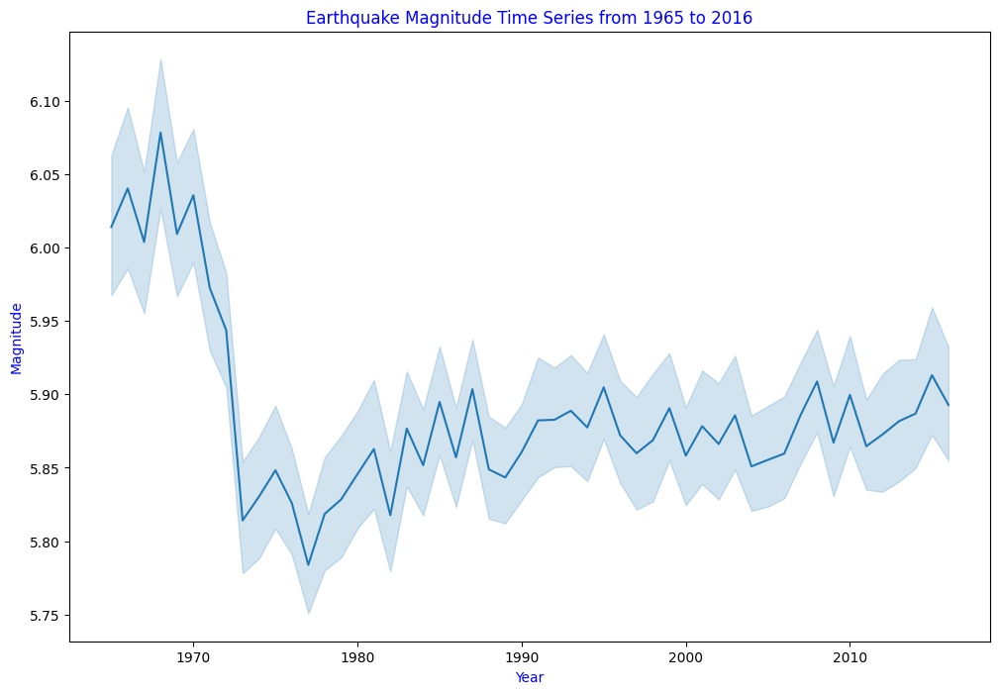

In [ ]:
# Creating a line plot of magnitudes over time
plt.figure(figsize=(12,8))
earthquake_plot = sns.lineplot(x=data['Date'].dt.year, y="Magnitude", data=data, color="#1f77b4")
earthquake_plot.set_title("Earthquake Magnitude Time Series from 1965 to 2016", color="#0000FF")
earthquake_plot.set_ylabel("Magnitude", color="#0000FF")
earthquake_plot.set_xlabel("Year", color="#0000FF")


#### However, our dataset also encompasses earthquakes triggered by nuclear detonations, other types of explosions, and rockbursts. To accurately interpret earthquakes caused by natural causes(seismic activities), it's crucial to determine whether these high-magnitude events were the result of human activities. We'll delve into this aspect in more detail in the subsequent plot for better understanding.

Text(0.5, 0, 'Year')

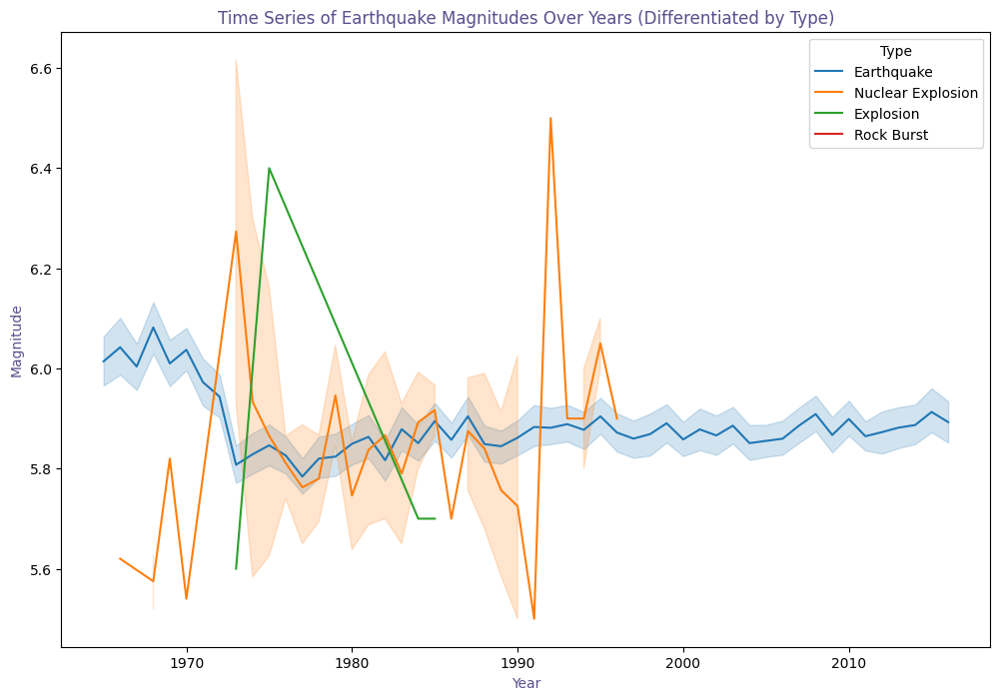

In [ ]:
plt.figure(figsize=(12,8))
colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728"]

# Creating a line plot of earthquake magnitudes over time, differentiated by type
time_series_by_type = sns.lineplot(x=data['Date'].dt.year, y="Magnitude", hue="Type", data=data, palette=colors)

# Setting the title, y-label, and x-label of the plot
time_series_by_type.set_title("Time Series of Earthquake Magnitudes Over Years (Differentiated by Type)", color="#58508d")
time_series_by_type.set_ylabel("Magnitude", color="#58508d")
time_series_by_type.set_xlabel("Year", color="#58508d")

**The plot indeed indicates a surge in high-magnitude events during the late 1960s and early 1970s. However, it's important to note that not all of these events were seismic in nature. A significant portion of them were linked to other factors. The graph reveals a spike in nuclear detonations and other types of explosions during the 1970s.**

#### Hence, we create plots to show the distribution of frequency of NATURAL EARTHQUAKES with certain depths and magnitudes.
#### We do so by filtering out the data related to earthquakes caused by various other causes such as nuclear explosions, rock bursts or explosions. We then use a vertical line to indicate their MEAN values.

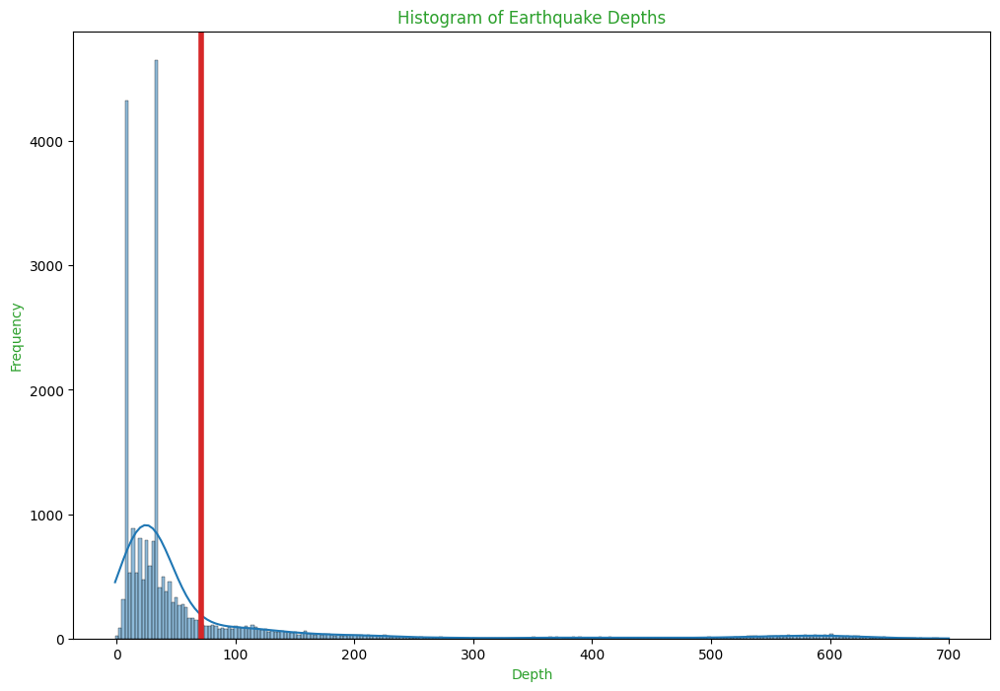

In [ ]:
#Histogram for the depth of earthquakes with vertical line for mean value:

# Filtering the data for only those data points that include Earthquakes caused by seismic activities
earthquake_data = data[data['Type'] == 'Earthquake']

plt.figure(figsize=(12,8))

# Getting the depth values and calculating the mean depth
depth_values = earthquake_data["Depth"].values
average_depth = earthquake_data["Depth"].mean()

# Creating a histogram for the depth of earthquakes
depth_histogram = sns.histplot(depth_values, color ="#1f77b4", kde=True)
depth_histogram.set_title("Histogram of Earthquake Depths", color="#2ca02c")
depth_histogram.set_ylabel("Frequency", color="#2ca02c")
depth_histogram.set_xlabel("Depth", color="#2ca02c")

# Adding a vertical line at the mean depth
plt.axvline(average_depth, 0, 1, color="#d62728", linewidth=4, label="Average Depth")


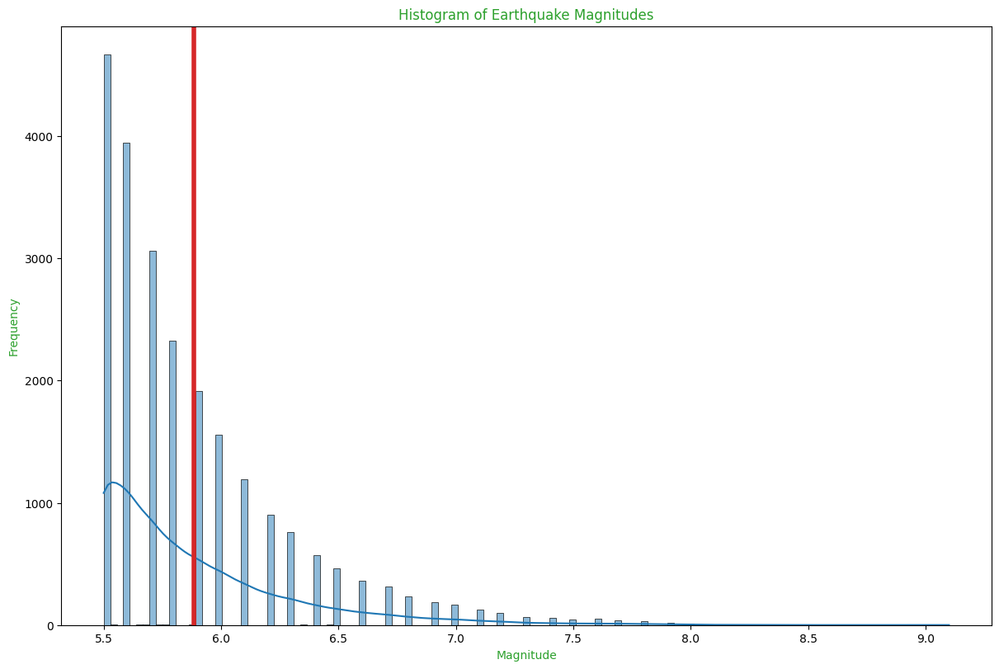

In [ ]:
# Histogram for the magnitude of earthquakes with vertical line for mean value:

# Filtering the data for only those data points that include Earthquakes caused by seismic activities
earthquake_data = data[data['Type'] == 'Earthquake']

fig = plt.figure(figsize=(12,8), constrained_layout=True)

# Getting the magnitude values and calculating the mean magnitude
magnitude_values = earthquake_data["Magnitude"].values
average_magnitude = earthquake_data["Magnitude"].mean()

# Creating a histogram for the magnitude of earthquakes
magnitude_histogram = sns.histplot(magnitude_values, color ="#1f77b4", kde=True)  # Changed color to a shade of blue
magnitude_histogram.set_title("Histogram of Earthquake Magnitudes", color="#2ca02c")  # Changed color to a shade of green
magnitude_histogram.set_ylabel("Frequency", color="#2ca02c")  # Changed color to a shade of green
magnitude_histogram.set_xlabel("Magnitude", color="#2ca02c")  # Changed color to a shade of green

# Adding a vertical line at the mean magnitude
plt.axvline(average_magnitude, 0, 1, color="#d62728", linewidth=4, label="Average Magnitude")  # Kept the color as a shade of red